In [141]:
import numpy as np

import math

# matplotlib for displaying the output
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 6)

# and IPython.display for audio output
import IPython.display as ipd

# Librosa for audio
import librosa
# And the display module for visualization
import librosa.display

import pyaudio
import csv

In [142]:
class OTW():
    
    def __init__(self, ref_recording, params, debug=False):
        # reference audio, fs = 22050
        self.ref, self.fs = librosa.load(ref_recording)
        
        # params
        self.fft_len = params['fft_len']
        self.hop_size = params['hop_size']
        self.search_band_width = params['search_band_width']
        self.max_run_count = params['max_run_count']  # max slope
        
        self.debug = debug
        
        # create STFT, spectrogram, and chromagram of reference audio
        # TODO: check additions (tuning, normalization, etc.)
        # note: using own stft function (vs. librosa's) b/c insert will also use self.stft
        stft_ref = self.stft(self.ref, self.fft_len, self.hop_size)
        spec_ref = np.abs(stft_ref)**2
        self.chromafb = librosa.filters.chroma(self.fs, self.fft_len)
        raw_chroma_ref = np.dot(self.chromafb, spec_ref)
        self.chroma_ref = librosa.util.normalize(raw_chroma_ref, norm=2, axis=0)
        
        if self.debug:
            plt.figure(figsize=(10, 4))
            librosa.display.specshow(self.chroma_ref, y_axis='chroma', x_axis='time')
            plt.colorbar()
            plt.title('Reference Chromagram')
            plt.tight_layout()
        
        # initialize arrays and matrices for live audio
        # double length of ref chroma for live chroma to make sure there is enough space w/out dynamically changing
        self.N = self.chroma_ref.shape[1] * 2  # rows are live
        self.M = self.chroma_ref.shape[1]      # cols are ref
        self.C = np.zeros((self.N, self.M))
        self.D = np.empty((self.N, self.M))
        self.D.fill(float('inf'))
        
        self.chroma_live = np.zeros((12, self.N))
        
        # TODO: use pyaudio buffer
        self.buf = []
        self.path = []
        
        # pointers & variables for OTW algorithm
        self.cost_matrix_ptr = 0
        self.ref_ptr = 0
        self.live_ptr = 0
        self.previous = None
        self.run_count = 0
        
        if self.debug:
            self.chroma_ptr = 0
        
    def insert(self, live_audio_buf):
        # store incoming music
        self.buf += live_audio_buf
        
        # dealing with out of bounds issue
        if self.ref_ptr >= self.M - 1 or self.live_ptr >= self.N - 1:
            return "stop"
        
        # OTW algorithm:
        # identify window for one chroma col
        while len(self.buf) >= self.fft_len:
            section = np.array(self.buf[:self.fft_len])
            self.buf = self.buf[self.hop_size:]
            win = section * np.hanning(len(section))
            chroma = librosa.feature.chroma_stft(y=win, sr=self.fs, n_fft=self.fft_len, hop_length=self.hop_size)
            
            dft = np.fft.rfft(win)
            spec = np.abs(dft)**2
            raw_chroma = np.dot(self.chromafb, spec)
            chroma = librosa.util.normalize(raw_chroma, norm=2, axis=0)
            
            if self.debug:
                self.chroma_live[:, self.chroma_ptr] = chroma
                self.chroma_ptr += 1

            # update cost matrix
            self.update_cost_matrix(chroma)
            
            # update distance (ie total path cost) matrix
            while (self.ref_ptr < self.cost_matrix_ptr - 1) and (self.live_ptr < self.N - 1):
                inc = self.get_inc()
                
                if inc != "column":
                    self.live_ptr += 1
                    for k in range(self.ref_ptr - self.search_band_width + 1, self.ref_ptr + 1):
                        if k > 0:
                            self.update_distance_matrix(self.live_ptr, k)
                
                if inc != "row":
                    self.ref_ptr += 1
                    for k in range(self.live_ptr - self.search_band_width + 1, self.live_ptr + 1):
                        if k > 0:
                            self.update_distance_matrix(k, self.ref_ptr)

                if inc == self.previous:
                    self.run_count += 1
                else:
                    self.run_count = 1
                
                if inc != "both":
                    self.previous = inc

                # update path
                self.path.append((self.ref_ptr, self.live_ptr))
            

    def debug_on(self):
        self.debug = True
        
    def debug_off(self):
        self.debug = False
    
    ########################
    ##  Helper functions  ##
    ########################
    
    def update_cost_matrix(self, chroma):
        ''' 
        Assumes chroma is just one column.
        Adds new row to matrix.
        '''
        
        cost = np.empty((1, self.M))
        for i in range(self.M):
            cost[0, i] = 1 - np.true_divide(np.dot(self.chroma_ref[:, i], chroma), (np.linalg.norm(self.chroma_ref[:, i]) * np.linalg.norm(chroma)))

        self.C[self.cost_matrix_ptr, :] = cost[0, :]

        # if first time adding to cost matrix, also initialize distance matrix
        if self.cost_matrix_ptr == 0:
            self.D[0, 0] = self.C[0, 0]

        self.cost_matrix_ptr += 1
        
    def get_inc(self):
        if self.live_ptr < self.search_band_width:
            return "both"

        if self.run_count > self.max_run_count:
            if self.previous == "row":
                return "column"
            else:
                return "row"
        
        y1 = self.live_ptr
        x1 = self.ref_ptr - self.search_band_width + np.argmin(self.D[y1, self.ref_ptr - self.search_band_width : self.ref_ptr + 1])
        x2 = self.ref_ptr
        y2 = self.live_ptr - self.search_band_width + np.argmin(self.D[self.live_ptr - self.search_band_width : self.live_ptr + 1, x2])
        (x, y) = (x1, y1) if (self.D[y1, x1] < self.D[y2, x2]) else (x2, y2)
        
        if x < self.ref_ptr:
            return "row"
        elif y < self.live_ptr:
            return "column"
        return "both"

    def update_distance_matrix(self, i, j):
        costs = []
        if i > 0:
            costs.append(self.D[i-1, j])
        if j > 0:
            costs.append(self.D[i, j-i])
        if i > 0 and j > 0:
            costs.append(self.D[i-1, j-1])
        
        if costs != []:
            cost = min(costs)
            self.D[i, j] = cost + self.C[i, j]
        
        # else, self.D[i, j] will remain 'inf'
        
    def stft(self, x, fft_len, hop_size):
        L = fft_len
        H = hop_size

        # use centered window by zero-padding
        x = np.concatenate((np.zeros(L/2), x))

        N = len(x)

        num_bins = 1 + L/2
        num_hops = int(((N - L)/H) + 1)

        stft = np.empty((num_bins, num_hops), dtype=complex)

        M = num_hops
        if self.debug:
            print "Calculating dft for", M, "hops."
        
        for m in range(M):
            section = x[(m*H):((m*H) + L)]
            win = section * np.hanning(len(section))
            stft[:, m]= np.fft.rfft(win)

        return stft

Calculating dft for 2873 hops.


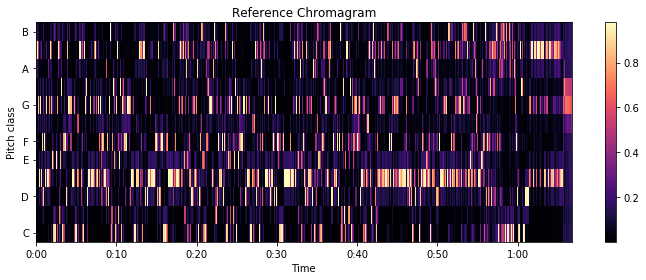

In [156]:
# TODO: different params: search_band_width, max_run_count
params = {'fft_len': 4096, 'hop_size': 2048, 'search_band_width': 10, 'max_run_count': 3}
otw = OTW('Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.wav', params, debug=True)
ipd.Audio(otw.ref, rate=otw.fs) 

In [157]:
live_music, fs = librosa.load('Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.wav')
ipd.Audio(live_music, rate=fs)

In [158]:
for i in range(0, 100):
    buf = live_music[4096*i:(4096*(i+1))].tolist()
    otw.insert(buf)

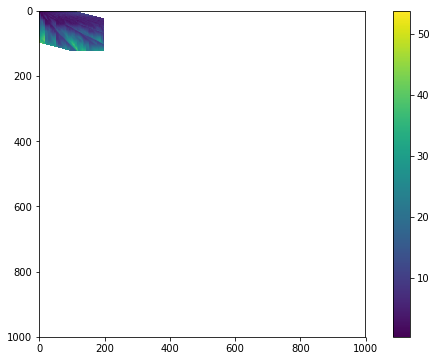

In [146]:
# with search band of 100
plt.imshow(otw.D[:1000, :1000])
plt.colorbar()

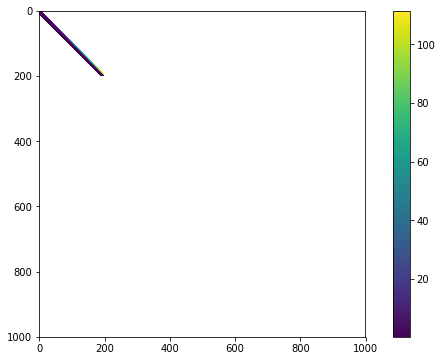

In [159]:
# with search band of 10
plt.imshow(otw.D[:1000, :1000])
plt.colorbar()

In [167]:
class test_single_recording():
    
    def __init__(self, ref_recording, live_recording, ref_ground_truth, live_ground_truth, params, debug=False):
        # TODO: pass in 'dtw', which is some form of DTW_x...
        
        self.dtw = OTW(ref_recording, params, debug)  
        self.live_recording, fs = librosa.load(live_recording)
        self.debug = debug
        
        self.ref_ground_truth_time = []
        self.ref_ground_truth_beats = []
        self.live_ground_truth_time = []
        self.live_ground_truth_beats = []
        
        ref_song = ref_recording[:-4]
        if self.debug:
            print "Reference song:", ref_song
        ref_csv_file = ref_song + '.csv'
        live_song = live_recording[:-4]
        if self.debug:
            print "Live song:", live_song
        live_csv_file = live_song + '.csv'
     
        with open(ref_csv_file) as ref_csv_data:
            reader = csv.reader(ref_csv_data)
            for row in reader:
                self.ref_ground_truth_time.append(float(row[0]))
                self.ref_ground_truth_beats.append(float(row[1]))
                
        with open(live_csv_file) as live_csv_data:
            reader = csv.reader(live_csv_data)
            for row in reader:
                self.live_ground_truth_time.append(float(row[0]))
                self.live_ground_truth_beats.append(float(row[1]))
        
    def evaluate(self, buf_size):
        '''Evaluate single piece of music with one DTW variant.'''
        # Emulate live recording via creation of buffers
        buffers = np.array_split(self.live_recording, buf_size)
        # For each buffer, get the synchronization estimate (ie the estimated position)
        # via call to insert
        for buf in buffers:
            est = self.dtw.insert(buf.tolist())
            if est == "stop":
                break
        
        self.sync_ests = self.dtw.path
        
        if self.debug:
            # show live chroma
            plt.figure(figsize=(10, 4))
            librosa.display.specshow(self.dtw.chroma_live, y_axis='chroma', x_axis='time')
            plt.colorbar()
            plt.title('Live Chromagram')
            plt.tight_layout()
            # show distance matrix
            plt.figure()
            plt.imshow(self.dtw.D)
            plt.colorbar()
            plt.title('Distance Matrix')
            plt.tight_layout()
        
        # Compare estimates to ground truth, and return error
        error = self.get_error()
        return error
    
    def get_error(self):
        error = 0
        num_off = 0
        for (l, r) in self.sync_ests:
            l_beat = self.get_beat(l, self.live_ground_truth_time, self.live_ground_truth_beats)
            r_beat = self.get_beat(r, self.ref_ground_truth_time, self.ref_ground_truth_beats)
            diff = (r_beat - l_beat)**2
            if r_beat - l_beat != 0:
                num_off += 1
            error += diff
        if self.debug:
            print "Error:", error
            print "Percent incorrect:", float(num_off) / len(self.live_ground_truth_beats)
        return error
        
    def get_beat(self, t, gtime, gbeats):
        '''Given a point and set of ground truths, determine which beat it was closest to.''' 
        ff = float(self.dtw.fs) / self.dtw.hop_size
        gsam = [x * ff for x in gtime]
        for i in range(len(gsam) - 1):
            if gsam[i] <= t < gsam[i+1]:
                return gbeats[i]
        # TODO: find better alternative return value
        return 0
        

Calculating dft for 2873 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Error: 1844683.0
Percent incorrect: 21.5757575758


1844683.0

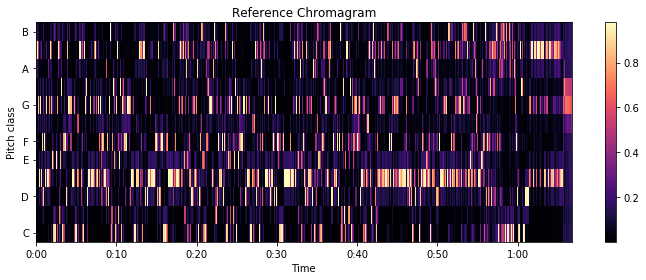

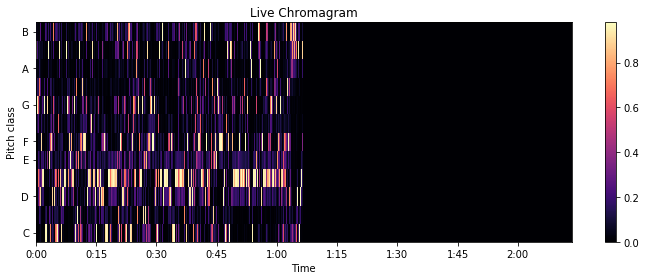

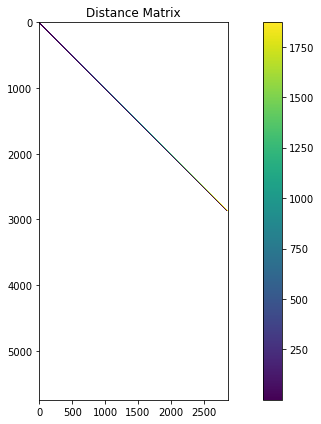

In [168]:
params = {'fft_len': 4096, 'hop_size': 2048, 'search_band_width': 20, 'max_run_count': 3}
ref ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.wav'
live = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.wav'
gt_ref = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.csv'
gt_live = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.csv'
test = test_single_recording(ref, live, gt_ref, gt_live, params, debug=True)
test.evaluate(4096)

Calculating dft for 2873 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Error: 5363412.0
Percent incorrect: 38.7121212121


5363412.0

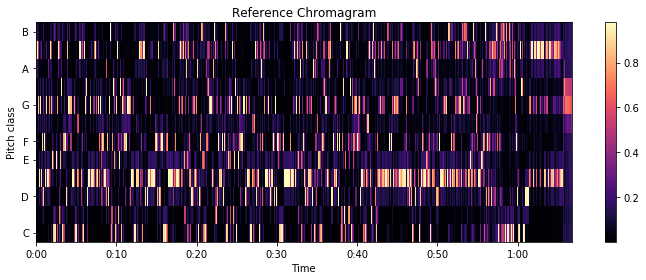

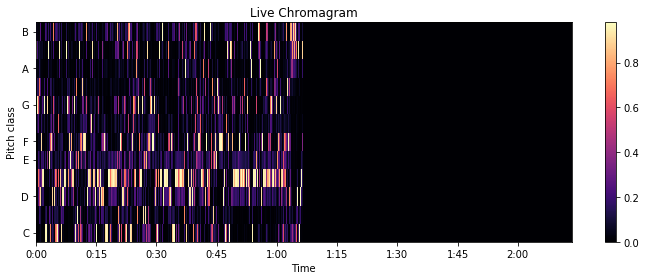

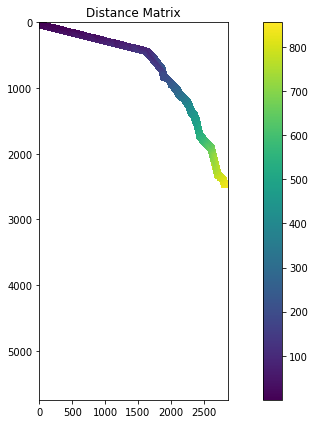

In [169]:
paramsb = {'fft_len': 4096, 'hop_size': 2048, 'search_band_width': 100, 'max_run_count': 3}
testb = test_single_recording(ref, live, gt_ref, gt_live, paramsb, debug=True)
testb.evaluate(4096)

Calculating dft for 2873 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi
Error: 1154679.0
Percent incorrect: 17.9393939394


1154679.0

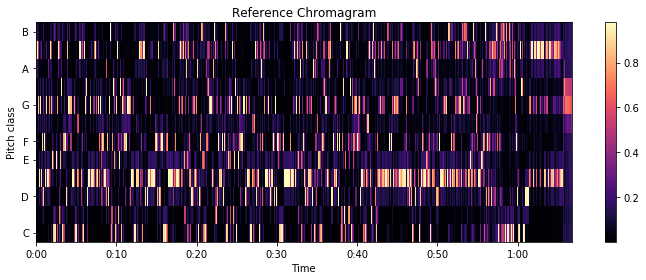

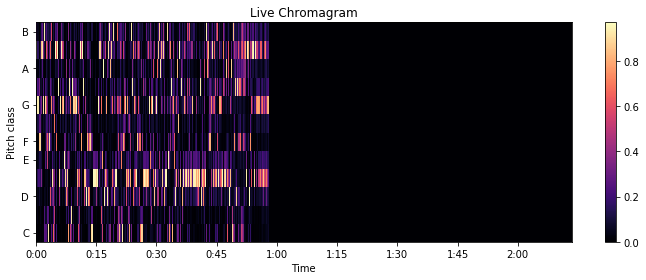

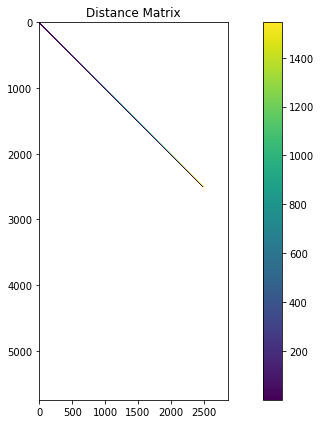

In [170]:
ref2 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.wav'
live2 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.wav'
gt_ref2 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.csv'
gt_live2 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.csv'
test2 = test_single_recording(ref2, live2, gt_ref2, gt_live2, params, debug=True)
test2.evaluate(4096)

Calculating dft for 2873 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Error: 17291.0
Percent incorrect: 0.992424242424


17291.0

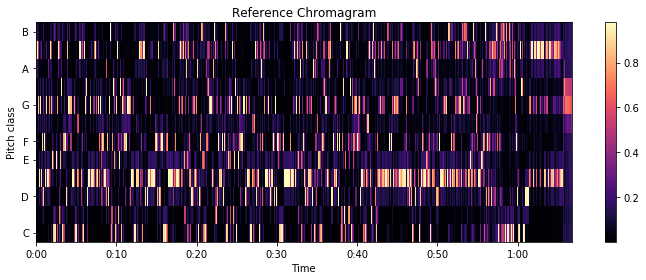

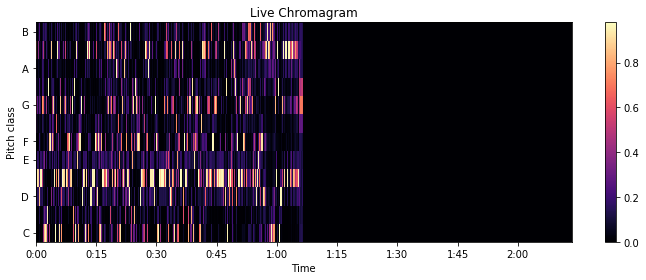

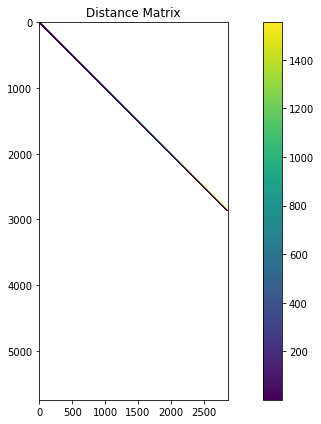

In [171]:
ref3 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.wav'
gt_ref3 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.csv'
test3 = test_single_recording(ref3, ref3, gt_ref3, gt_ref3, params, debug=True)
test3.evaluate(4096)

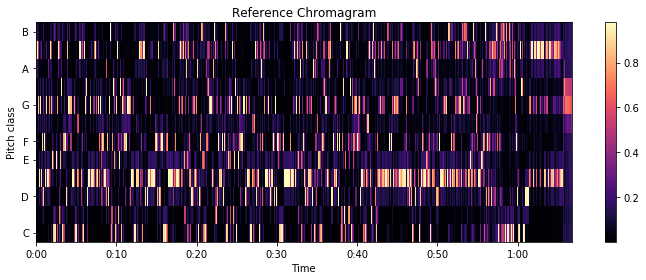

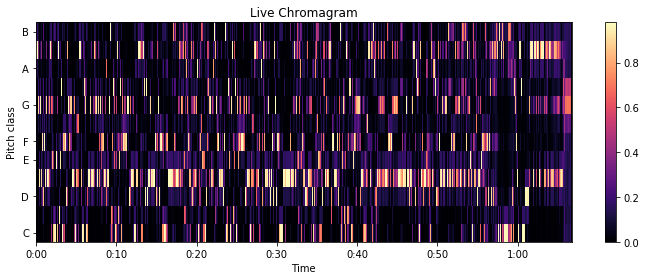

In [172]:
plt.figure(figsize=(10, 4))
librosa.display.specshow(test3.dtw.chroma_ref, y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title('Reference Chromagram')
plt.tight_layout()

plt.figure(figsize=(10, 4))
librosa.display.specshow(test3.dtw.chroma_live[:, : test3.dtw.M], y_axis='chroma', x_axis='time')
plt.colorbar()
plt.title('Live Chromagram')
plt.tight_layout()

In [173]:
print test4.dtw.path

[(1, 1), (2, 2), (3, 3), (4, 4), (5, 5), (6, 6), (7, 7), (8, 8), (9, 9), (10, 10), (11, 11), (12, 12), (13, 13), (14, 14), (15, 15), (16, 16), (17, 17), (18, 18), (19, 19), (20, 20), (21, 20), (22, 21), (23, 22), (24, 23), (25, 24), (26, 25), (27, 26), (28, 27), (29, 28), (30, 29), (31, 30), (32, 31), (33, 32), (34, 33), (35, 34), (36, 35), (37, 36), (38, 37), (39, 38), (40, 39), (41, 40), (42, 41), (43, 42), (44, 43), (45, 44), (46, 45), (47, 46), (48, 47), (49, 48), (50, 49), (51, 50), (52, 51), (53, 52), (54, 53), (55, 54), (56, 55), (57, 56), (58, 57), (59, 58), (60, 59), (61, 60), (62, 61), (63, 62), (64, 63), (65, 64), (66, 65), (67, 66), (68, 67), (69, 68), (70, 69), (71, 70), (72, 71), (73, 72), (74, 73), (75, 74), (76, 75), (77, 76), (78, 77), (79, 78), (80, 79), (81, 80), (82, 81), (83, 82), (84, 83), (85, 84), (86, 85), (87, 86), (88, 87), (89, 88), (90, 89), (91, 90), (92, 91), (93, 92), (94, 93), (95, 94), (96, 95), (97, 96), (98, 97), (99, 98), (100, 99), (101, 100), (102

Calculating dft for 3080 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Error: 17291.0
Percent incorrect: 0.992424242424


17291.0

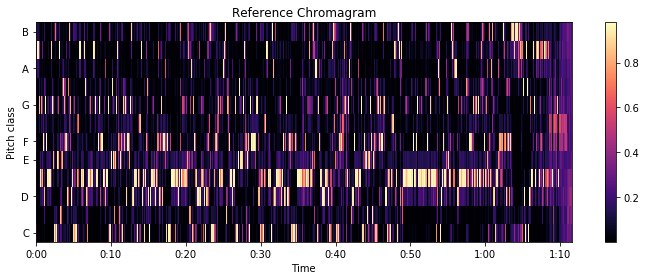

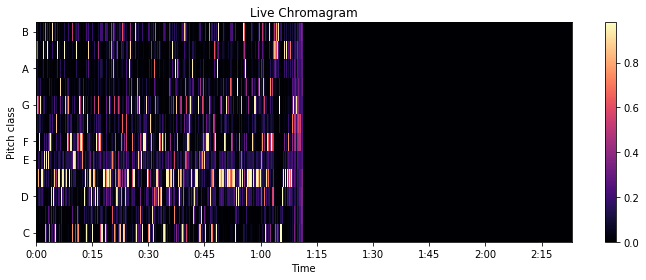

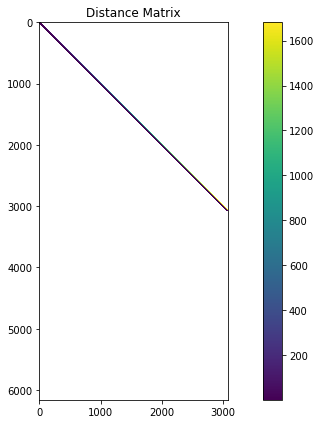

In [174]:
ref4 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.wav'
gt_ref4 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.csv'
test4 = test_single_recording(ref4, ref4, gt_ref4, gt_ref4, params, debug=True)
test4.evaluate(4096)

Calculating dft for 2508 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi
Error: 17291.0
Percent incorrect: 0.992424242424


17291.0

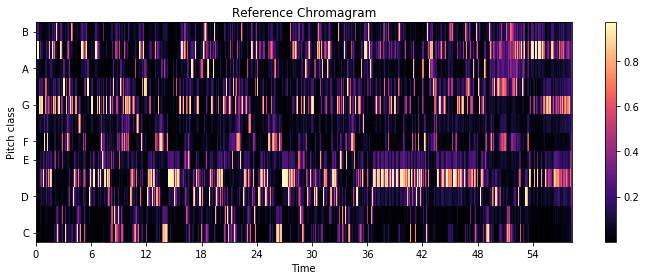

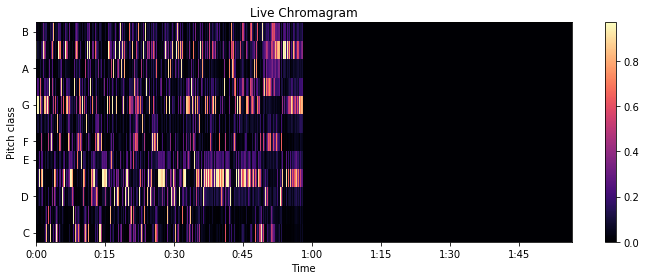

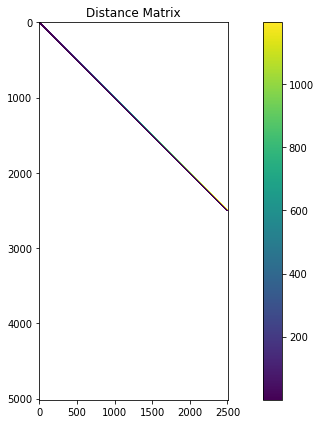

In [175]:
ref5 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.wav'
gt_ref5 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.csv'
test5 = test_single_recording(ref5, ref5, gt_ref5, gt_ref5, params, debug=True)
test5.evaluate(4096)

Calculating dft for 2508 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Error: 1591715.0
Percent incorrect: 18.6742424242


1591715.0

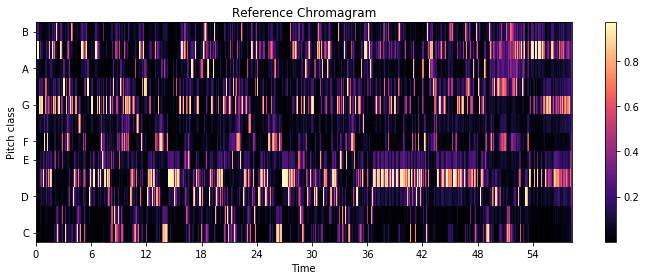

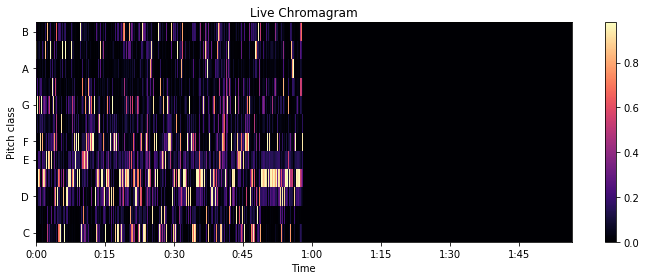

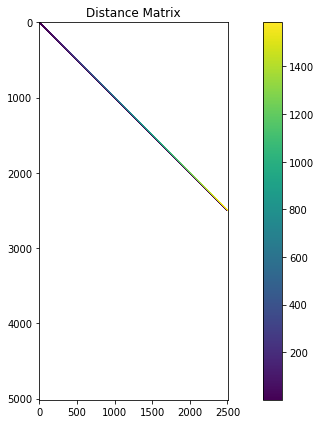

In [176]:
ref6 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.wav'
live6 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.wav'
gt_ref6 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.csv'
gt_live6 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.csv'
test6 = test_single_recording(ref6, live6, gt_ref6, gt_live6, params, debug=True)
test6.evaluate(4096)

Calculating dft for 2508 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Error: 1491614.0
Percent incorrect: 24.7727272727


1491614.0

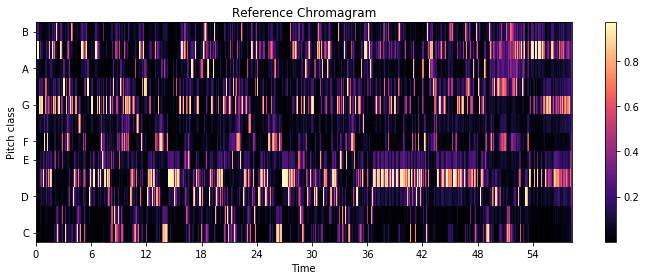

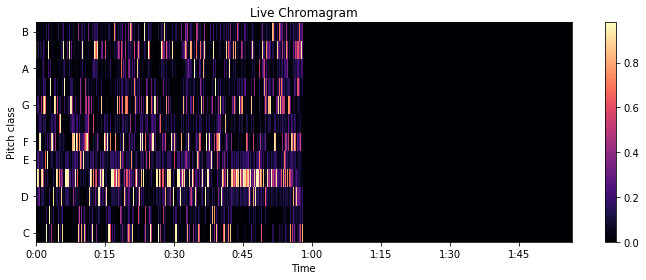

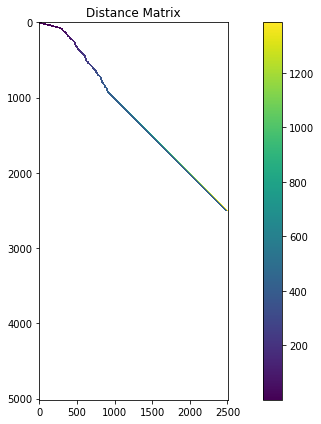

In [177]:
ref7 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.wav'
live7 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.wav'
gt_ref7 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.csv'
gt_live7 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.csv'
test7 = test_single_recording(ref7, live7, gt_ref7, gt_live7, params, debug=True)
test7.evaluate(4096)

Calculating dft for 3080 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein
Error: 1940959.0
Percent incorrect: 30.4621212121


1940959.0

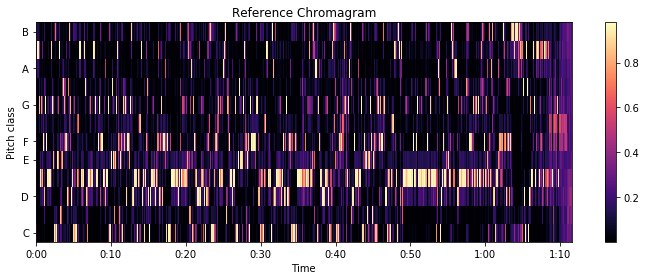

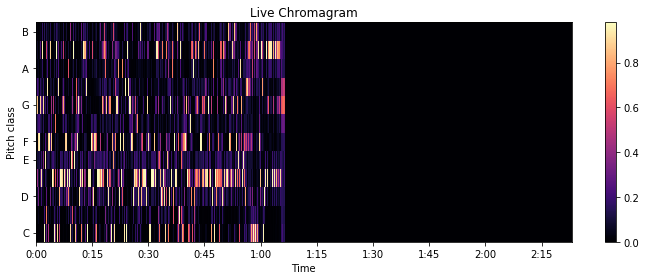

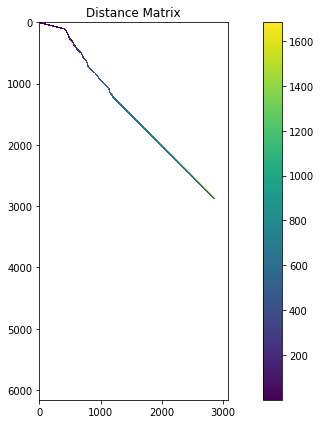

In [178]:
ref8 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.wav'
live8 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.wav'
gt_ref8 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.csv'
gt_live8 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_ArthurRubinstein.csv'
test8 = test_single_recording(ref8, live8, gt_ref8, gt_live8, params, debug=True)
test8.evaluate(4096)

Calculating dft for 3080 hops.
Reference song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff
Live song: Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi
Error: 1602521.0
Percent incorrect: 23.3333333333


1602521.0

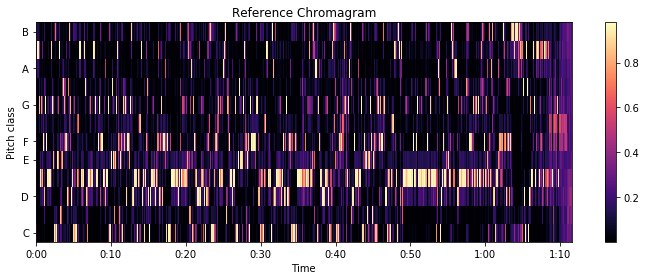

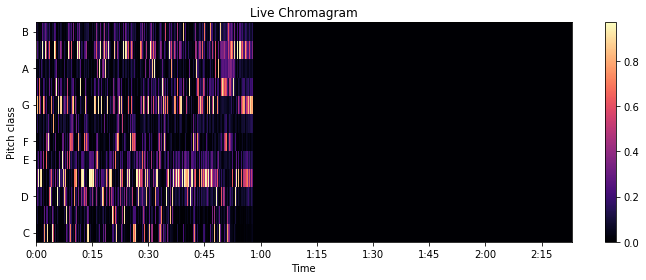

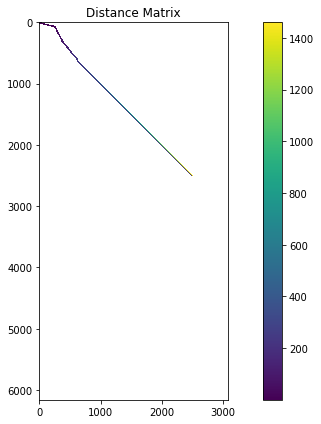

In [179]:
ref9 ='Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.wav'
live9 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.wav'
gt_ref9 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_Rachmaninoff.csv'
gt_live9 = 'Songs/ChopinNocturneOp9No2/ChopinNocturneOp9No2_YundiLi.csv'
test9 = test_single_recording(ref9, live9, gt_ref9, gt_live9, params, debug=True)
test9.evaluate(4096)